In [1]:
import scanpy as sc
import numpy as np
from moscot.problems.time import TemporalProblem
from cellrank.kernels import PseudotimeKernel

import os

In [48]:
def reprocess(adata):
    adata.layers["clean"] = sc.pp.log1p(
            sc.pp.normalize_total(adata, target_sum=1e4, inplace=False)[
                "X"
            ]
        )
    adata.obsm["clean_pca"] = sc.pp.pca(
            adata.layers["clean"],
            n_comps=300 if adata.shape[0] > 300 else adata.shape[0] - 2,
    )
    sc.pp.neighbors(adata, use_rep="clean_pca")
    sc.tl.leiden(adata, key_added="leiden_3", resolution=3.0)
    sc.tl.leiden(adata, key_added="leiden_2", resolution=2.0)
    sc.tl.leiden(adata, key_added="leiden_1", resolution=1.0)
    sc.tl.umap(adata)
    sc.tl.diffmap(adata)
    # create a meta group
    adata.obs["dpt_group"] = (
        adata.obs["disease_ontology_term_id"].astype(str)
        + "_"
        + adata.obs["cell_type_ontology_term_id"].astype(str)
        + "_"
        + adata.obs["tissue_ontology_term_id"].astype(str)
    )  # + "_" + adata.obs['dataset_id'].astype(str)

    # if group is too small
    okgroup = [i for i, j in adata.obs["dpt_group"].value_counts().items() if j >= 10]
    not_okgroup = [i for i, j in adata.obs["dpt_group"].value_counts().items() if j < 3]
    # set the group to empty
    adata.obs.loc[adata.obs["dpt_group"].isin(not_okgroup), "dpt_group"] = ""
    adata.obs["heat_diff"] = np.nan


    if adata.obs['organism_ontology_term_id'].iloc[0] in ['NCBITaxon:9606', "NCBITaxon:10090"]:
        org = "human" if adata.obs['organism_ontology_term_id'].iloc[0] == "NCBITaxon:9606" else "mouse"
        adata.var['ensembl_gene_id'] = adata.var.index
        adata.var = adata.var.set_index('symbol')
        adata.var.index = adata.var.index.astype(str)
        adata.var_names_make_unique()
        TemporalProblem(adata).score_genes_for_marginals(
            gene_set_proliferation=org, gene_set_apoptosis=org
        )
        prior_growth = np.exp((adata.obs["proliferation"].values - adata.obs["apoptosis"].values)/ 2)
        adata.obs['normalized_growth'] = prior_growth
        adata.var['symbol'] = adata.var.index
        adata.var = adata.var.set_index("ensembl_gene_id")
        # for each group
        for val in set(okgroup):
            if val == "":
                continue
            # get the best root cell
            eq = adata.obs.dpt_group == val
            loc = np.where(eq)[0]

            root_ixs = loc[adata.obs["normalized_growth"][eq].argmax()]
            adata.uns["iroot"] = root_ixs
            # compute the diffusion pseudo time from it
            sc.tl.dpt(adata)
            adata.obs.loc[eq, "heat_diff"] = adata.obs.loc[eq, "dpt_pseudotime"]
            adata.obs.drop(columns=["dpt_pseudotime"], inplace=True)

        # sort so that the next time points are aligned for all groups
        PseudotimeKernel(adata, time_key="normalized_growth").compute_transition_matrix().write_to_adata()
        adata = adata[adata.obs.sort_values(["dpt_group", "heat_diff"]).index]
    else:
        adata.obs["dpt_group"] = ""
    return adata

In [2]:
files = os.listdir("/home/ml4ig1/scprint/.lamindb/")

In [49]:
adata = reprocess(sc.read_h5ad("/home/ml4ig1/scprint/.lamindb/"+files[0]))

/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/anndata/_core/anndata.py:850: UserWarning: 
AnnData expects .var.index to contain strings, but got values like:
    ['TSPAN6', 'TNMD', 'DPM1', 'SCYL3', 'C1orf112']

    Inferred to be: categorical

  value_idx = self._prep_dim_index(value.index, attr)
/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/anndata/utils.py:260: UserWarning: Suffix used (-[0-9]+) to deduplicate index values may make index values difficult to interpret. There values with a similar suffixes in the index. Consider using a different delimiter by passing `join={delimiter}`Example key collisions generated by the make_index_unique algorithm: ['SNORD115-1', 'SNORD115-2', 'SNORD115-3', 'SNORD115-4', 'SNORD115-5']
  warnings.warn(


  0%|          | 0/34949 [00:00<?, ?cell/s]

10


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


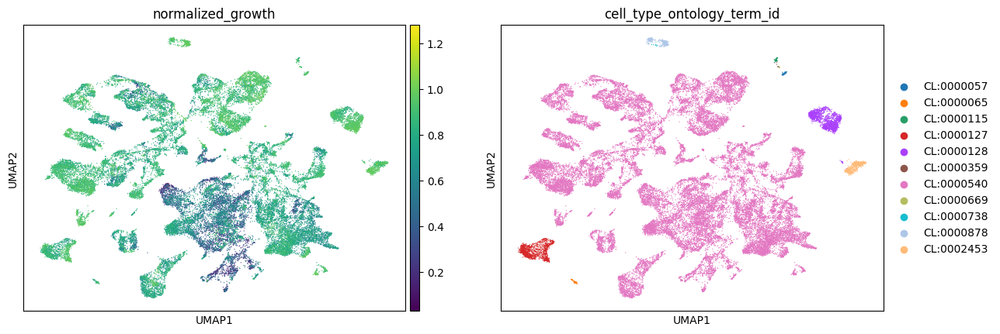

11


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


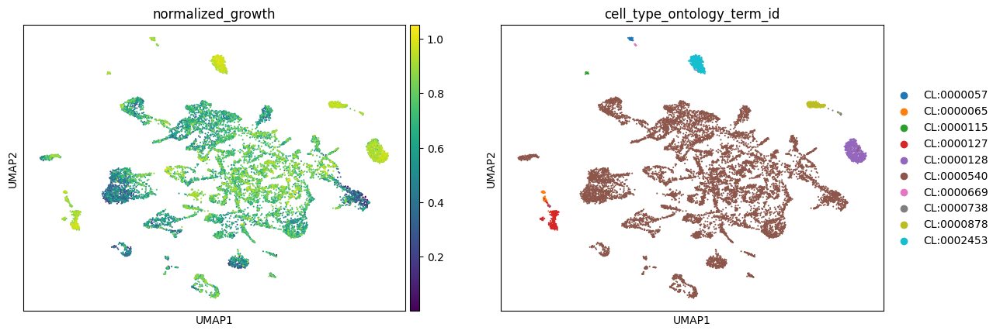

12


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


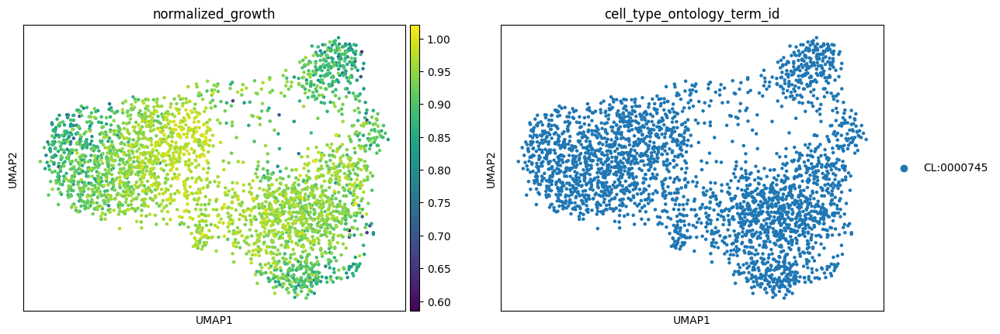

13


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


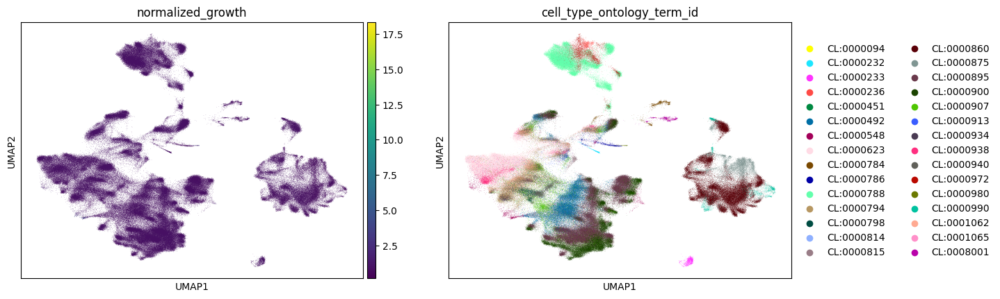

14


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


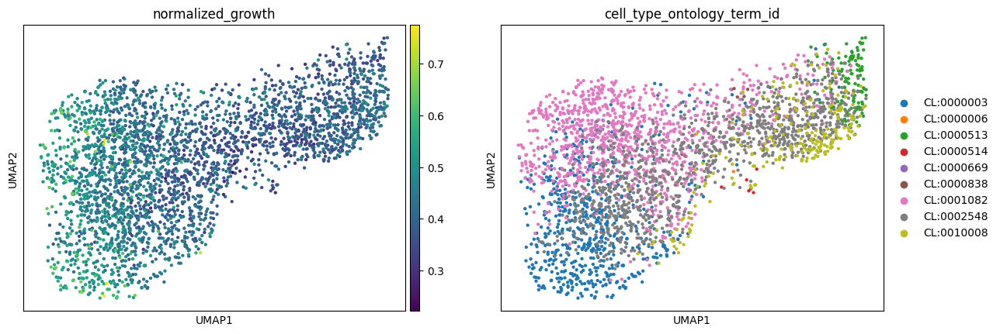

15


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


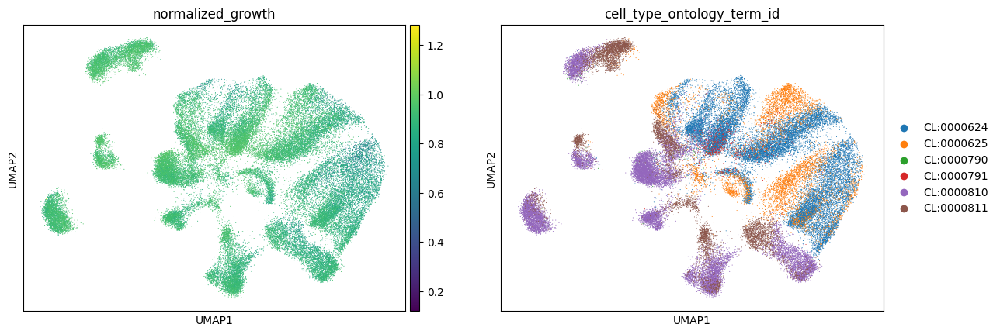

16


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


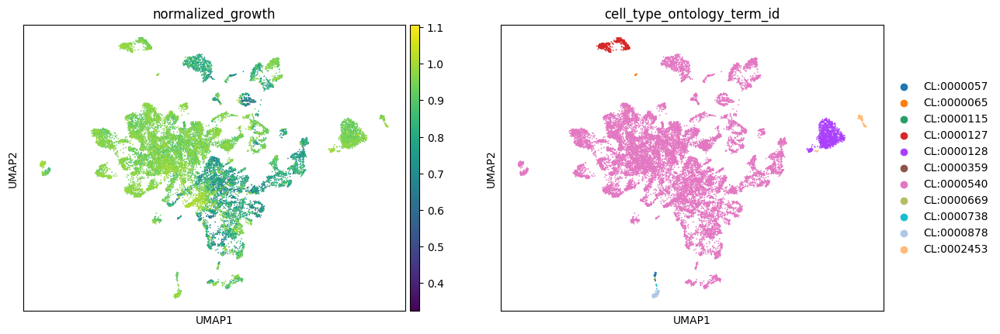

17


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


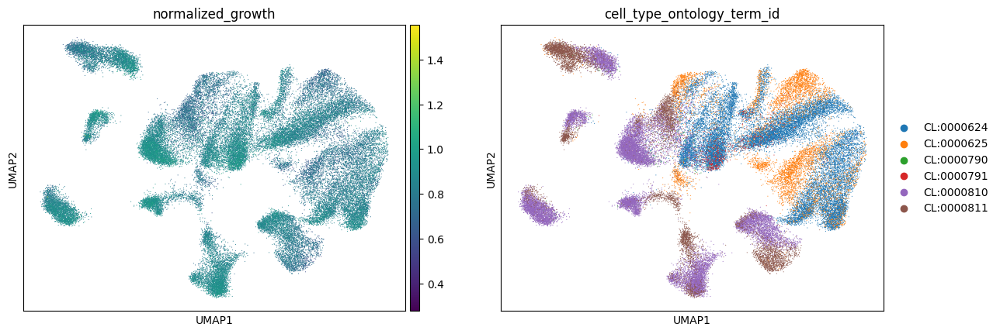

18


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


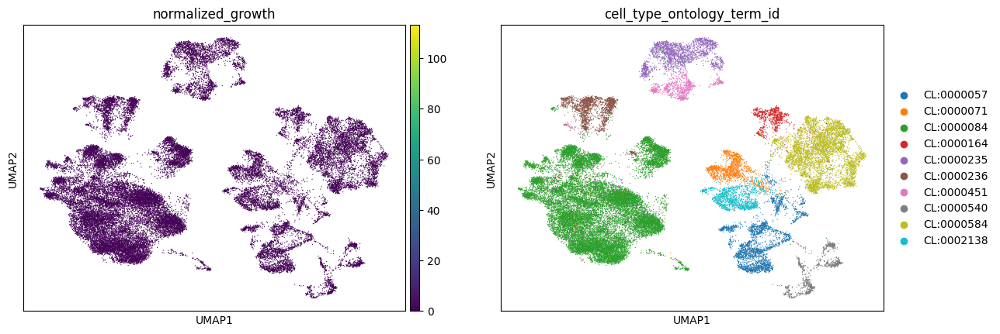

19


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


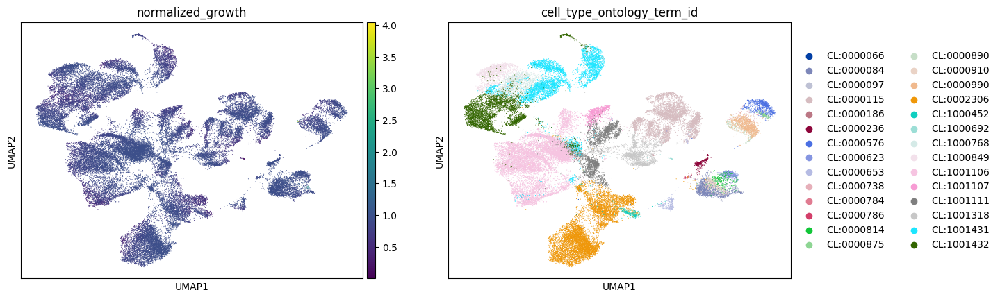

20


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


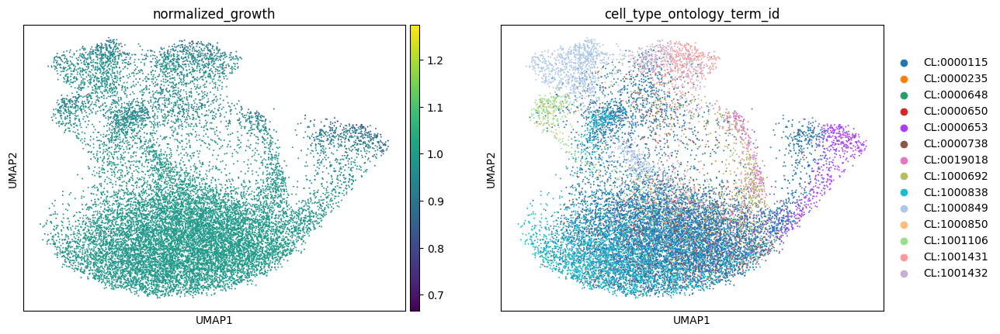

21


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


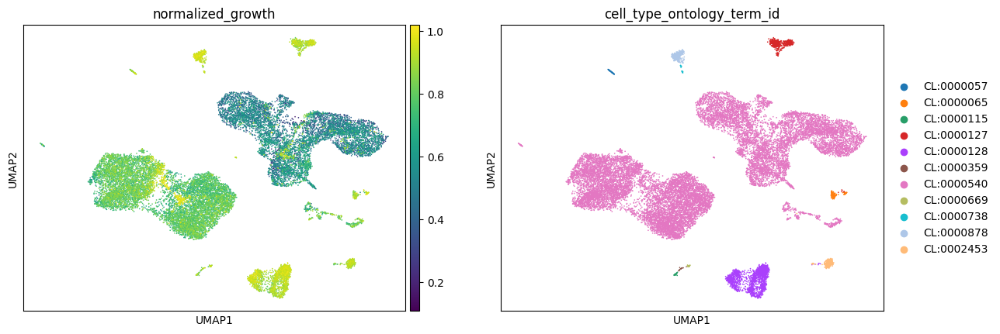

22


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


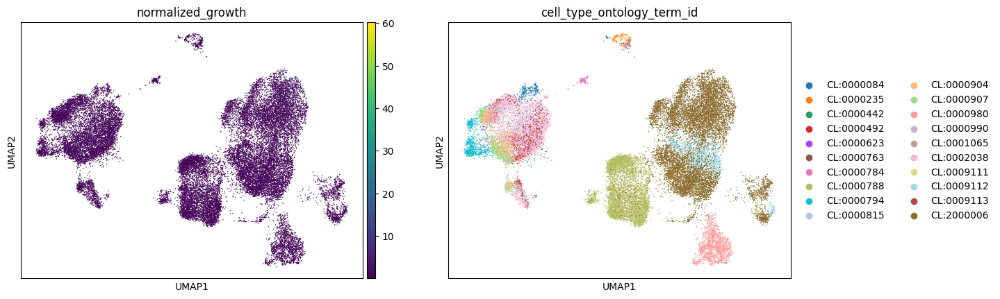

23


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


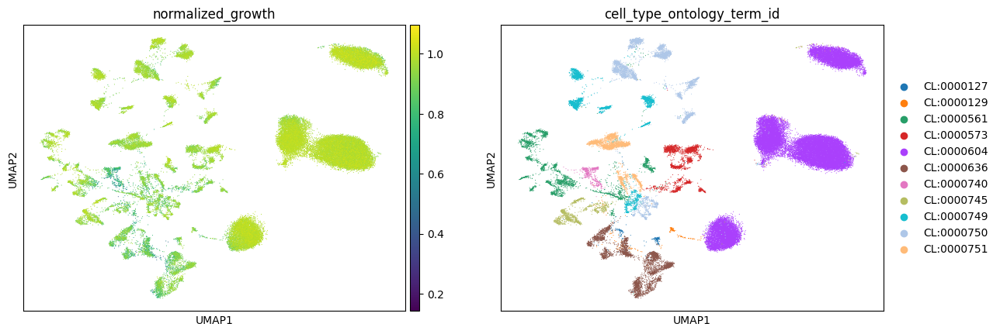

24


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


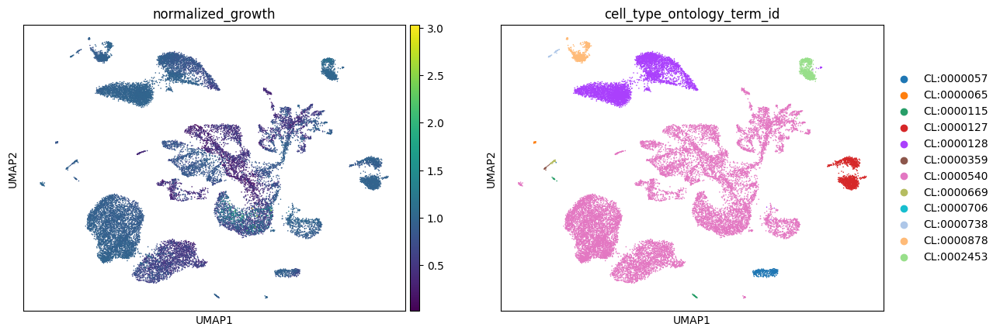

25


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


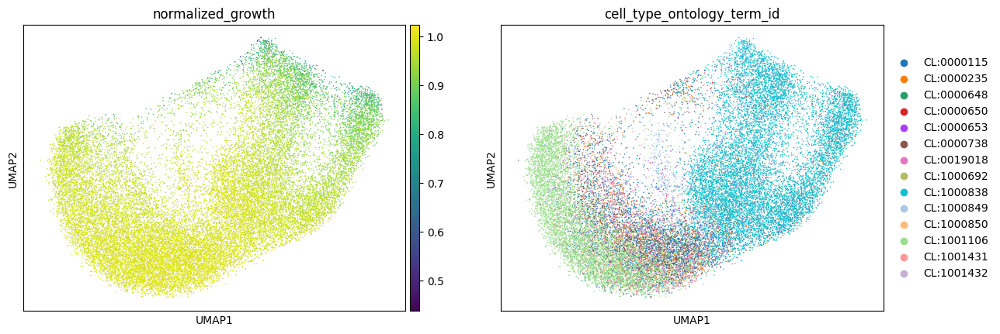

26


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


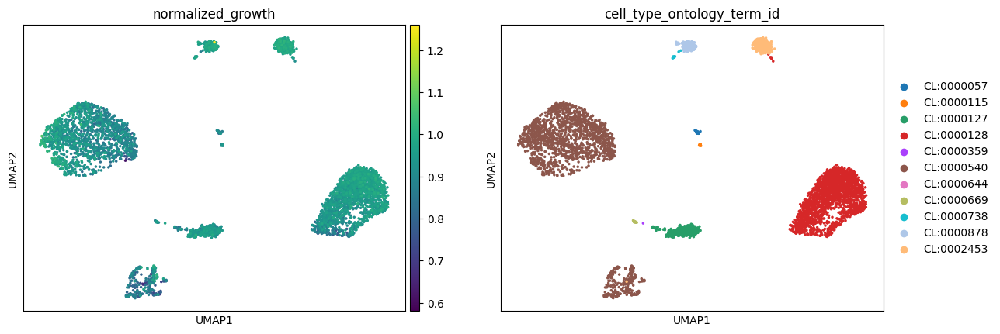

27


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


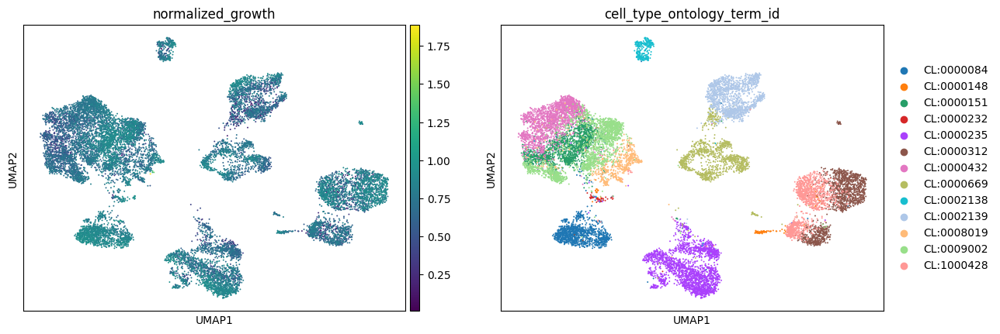

28


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


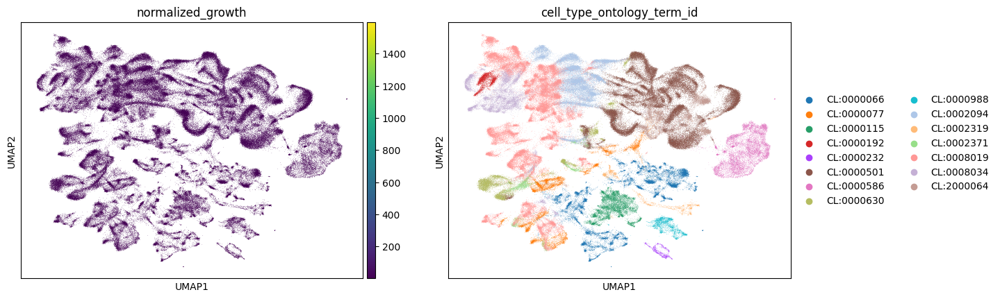

29


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


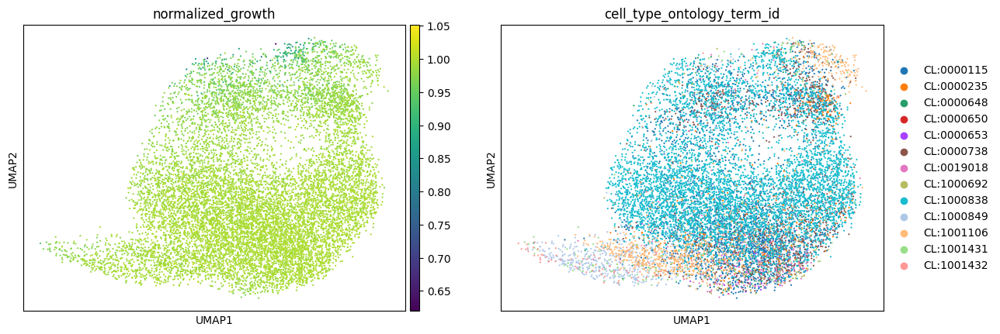

30


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


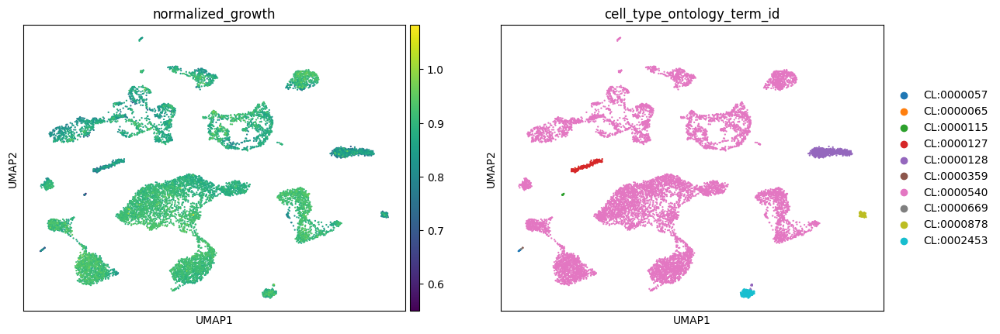

31


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


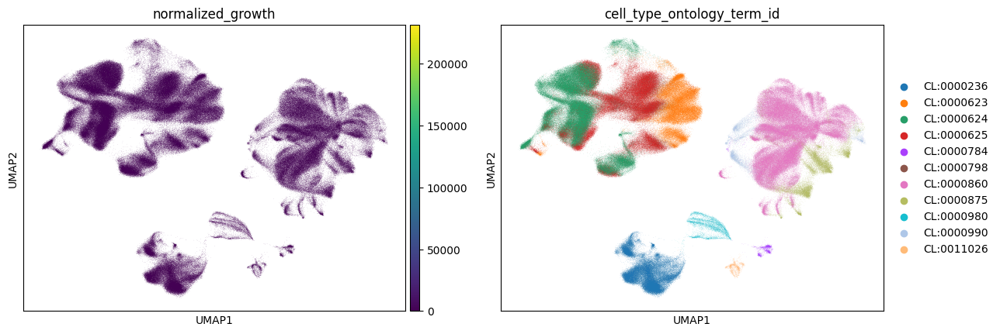

32


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


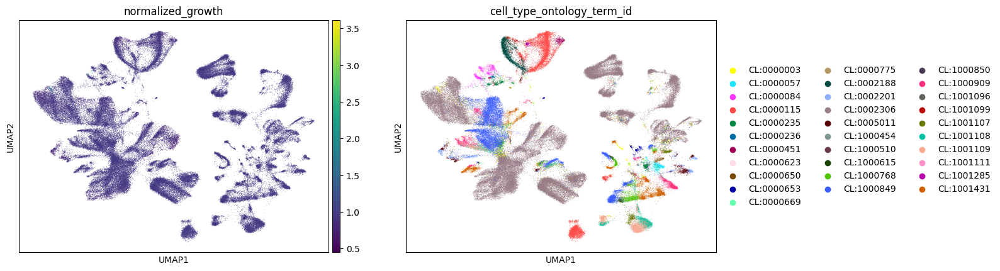

33


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


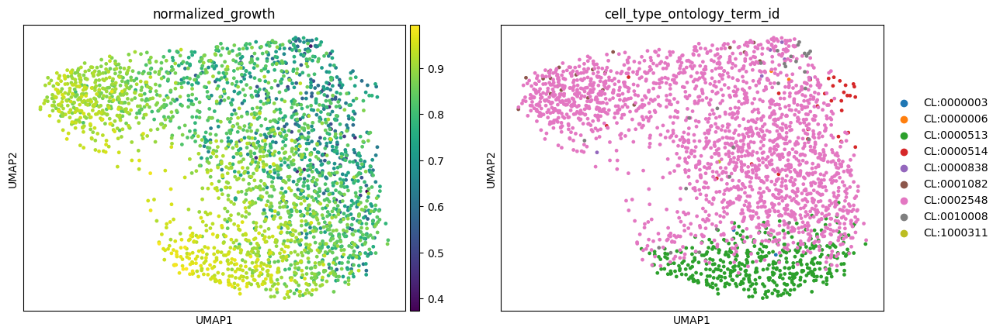

34


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


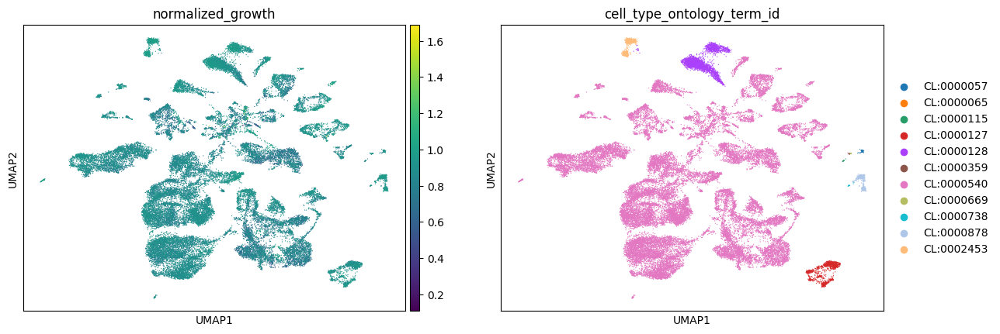

35


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


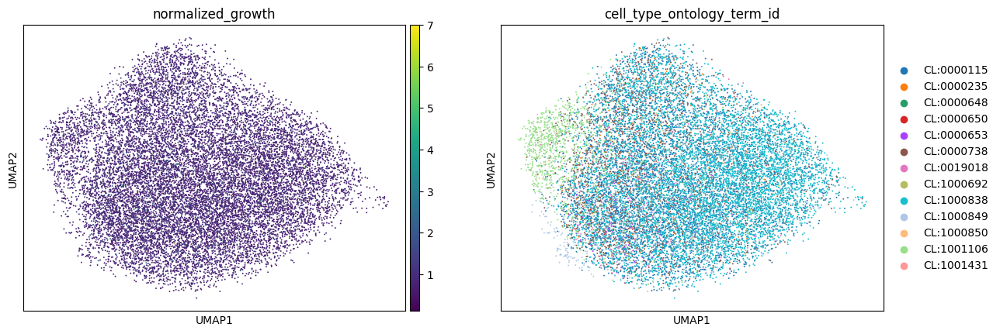

36


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


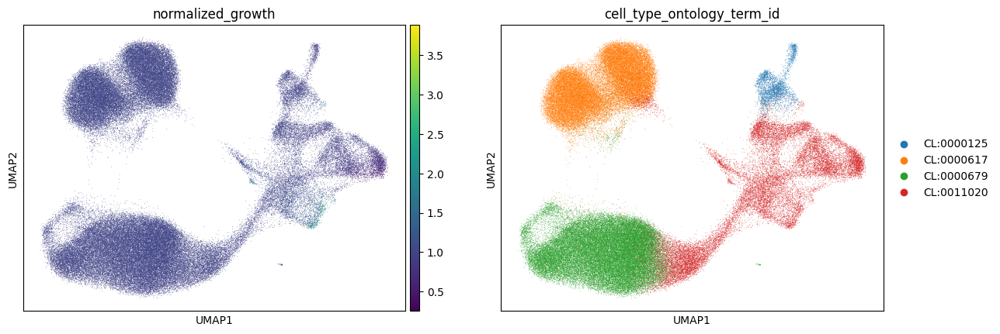

37


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


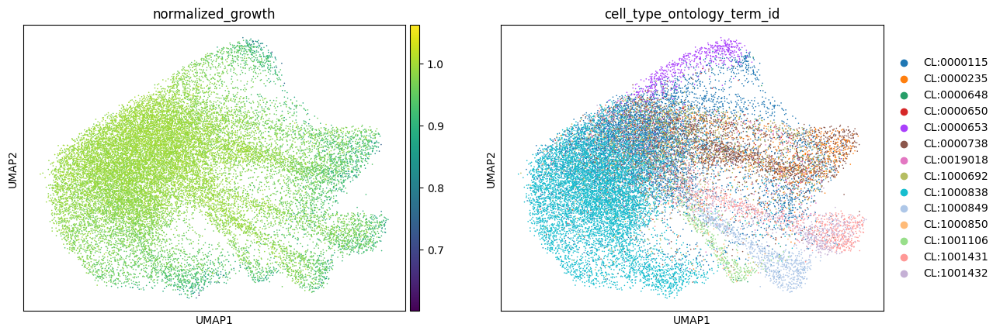

38


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


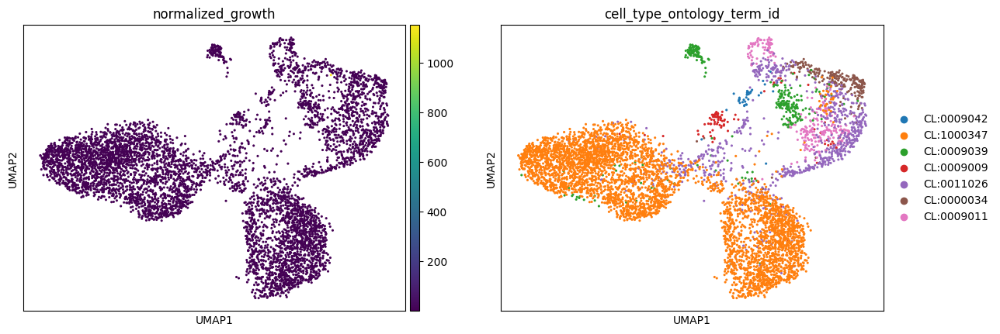

39


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


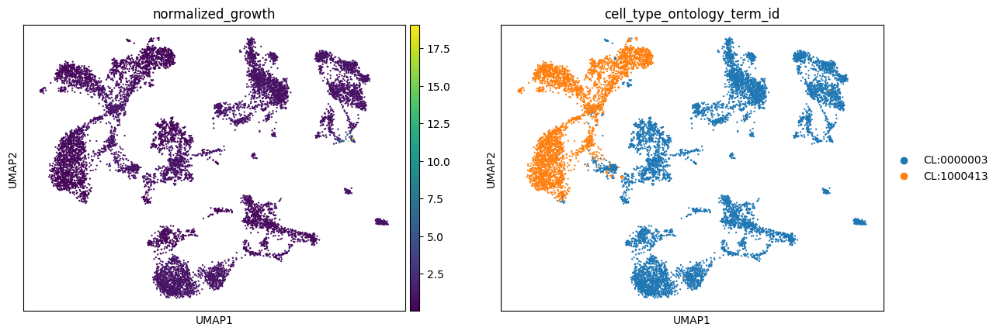

40


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


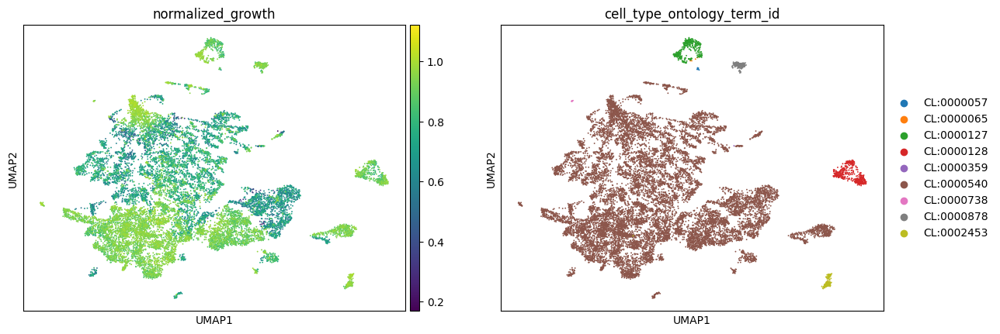

41


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


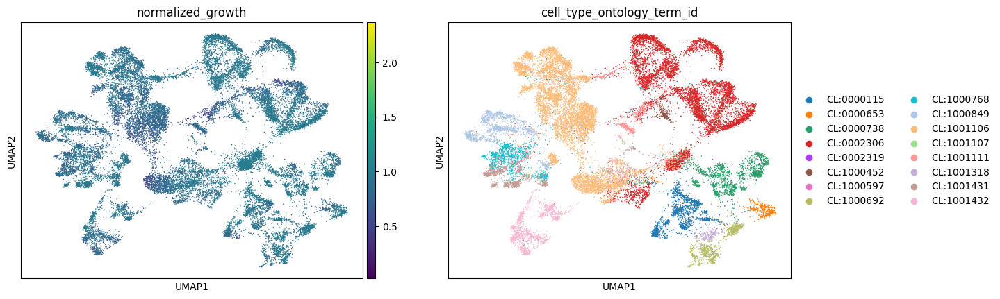

42


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


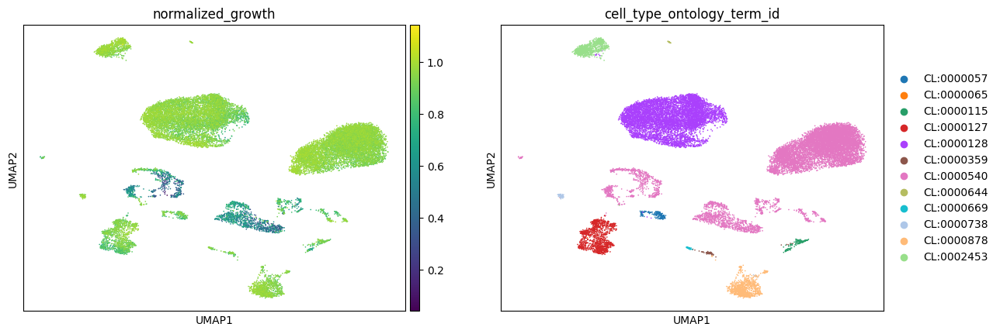

43


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


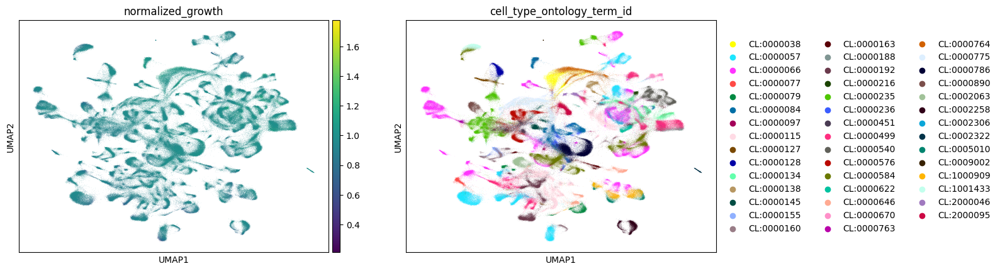

44


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


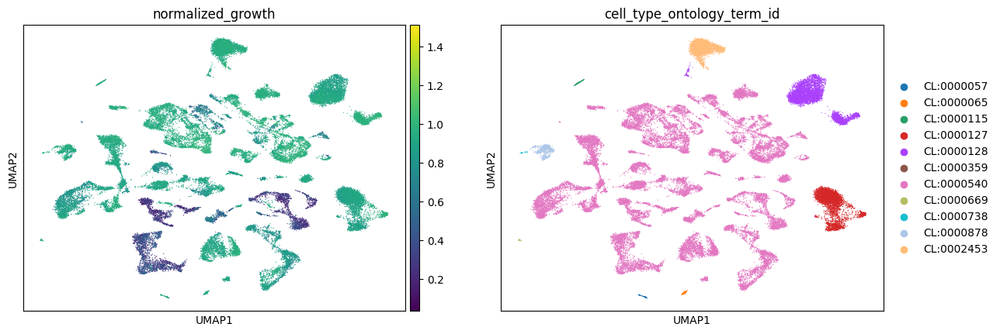

45


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


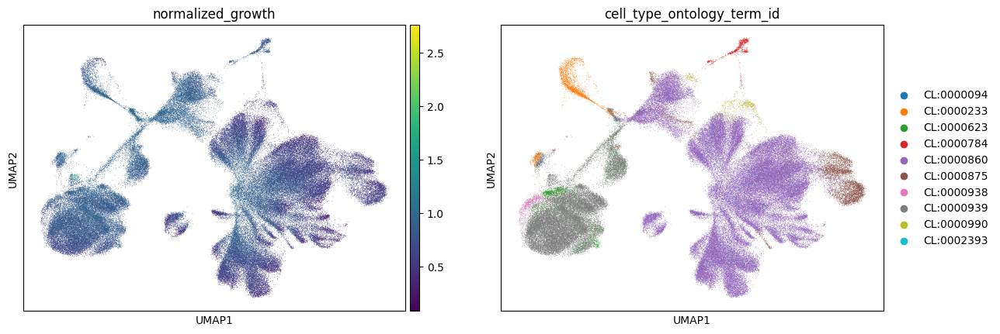

46


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


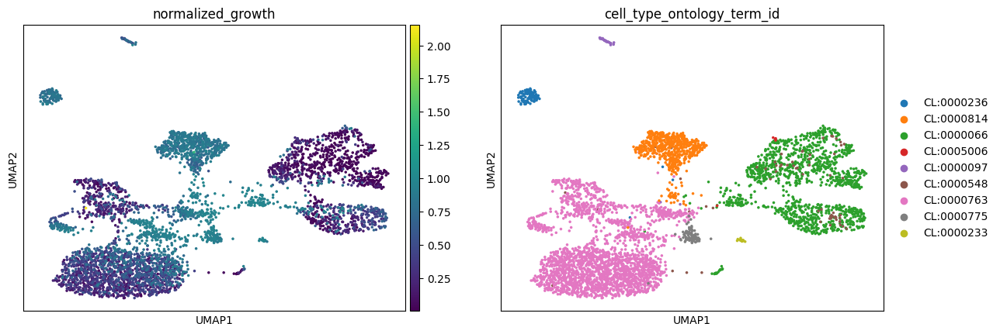

47


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


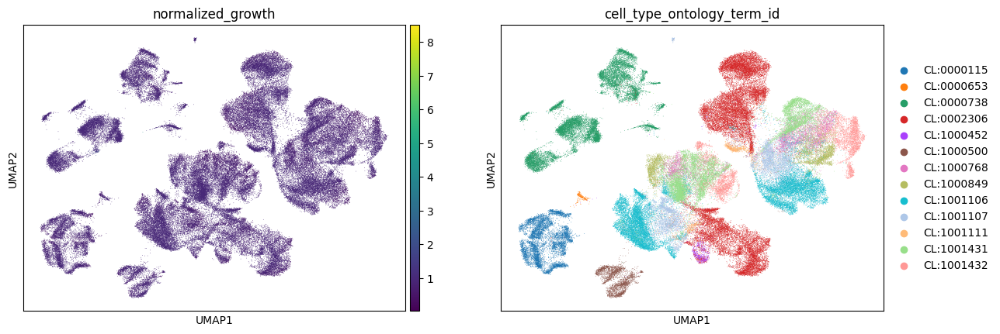

48


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


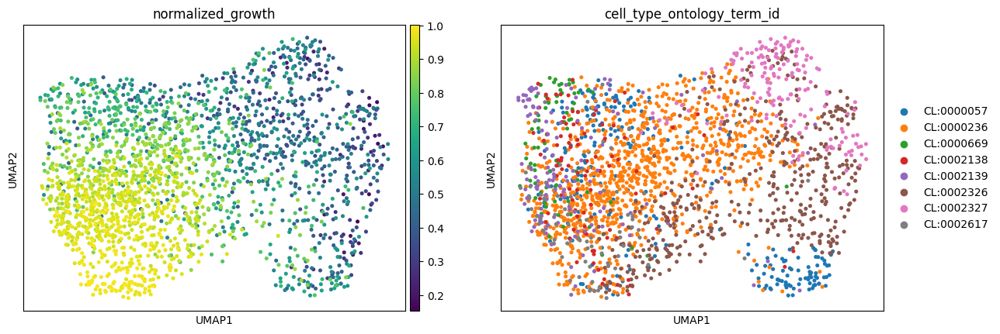

49


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


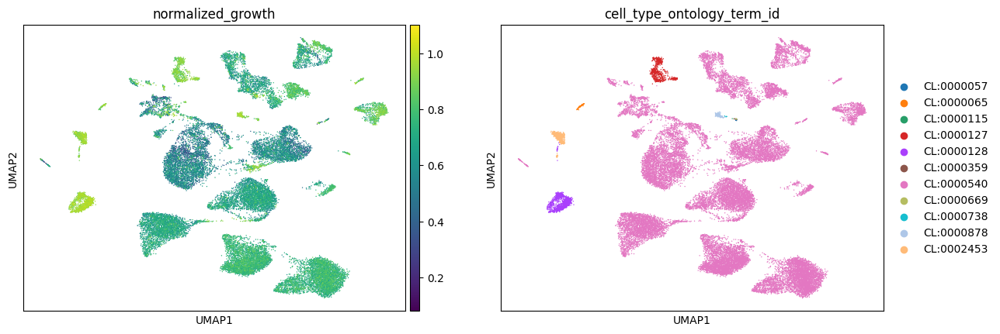

50


/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


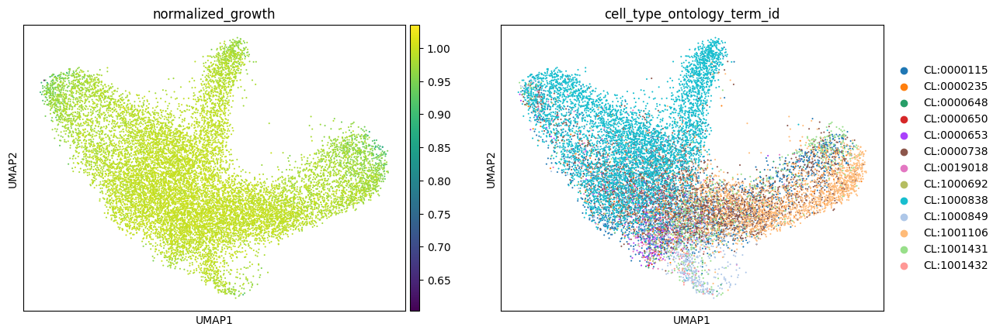

51


BlockingIOError: [Errno 11] Unable to synchronously open file (unable to lock file, errno = 11, error message = 'Resource temporarily unavailable')

In [31]:
for i, f in enumerate(files[10:]):
    print(10+i)
    adata = sc.read_h5ad("/home/ml4ig1/scprint/.lamindb/"+f, backed=True)
    sc.pl.embedding(adata, basis="umap", color=["normalized_growth", "cell_type_ontology_term_id"])

- file 50
- file 48
- file 37
- file 35
- file 33
- file 29
- file 25
- file 22
- file 20
- file 17 looks to be same as 15
- file 15
- file 14
- file 12 (weird, just one cell type, space)
- file 8 (slid seq)
- file 3 (slide-seq)
- file 2 (Visium and cells seem to be dying)

# most file only have neuron which suck

In [70]:
adata = sc.read_h5ad("/home/ml4ig1/scprint/.lamindb/"+files[14])

In [71]:
adata

AnnData object with n_obs × n_vars = 3083 × 70116
    obs: 'n_counts', 'n_genes', 'percent.mt', 'Adipocyte', 'Cardiomyocyte', 'Endothelial', 'Fibroblast', 'Lymphoid', 'Mast', 'Myeloid', 'Neuronal', 'Pericyte', 'Cycling.cells', 'vSMCs', 'cell_type_original', 'assay_ontology_term_id', 'cell_type_ontology_term_id', 'development_stage_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'is_primary_data', 'organism_ontology_term_id', 'sex_ontology_term_id', 'tissue_ontology_term_id', 'donor_id', 'suspension_type', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'cell_culture', 'nnz', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier

/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


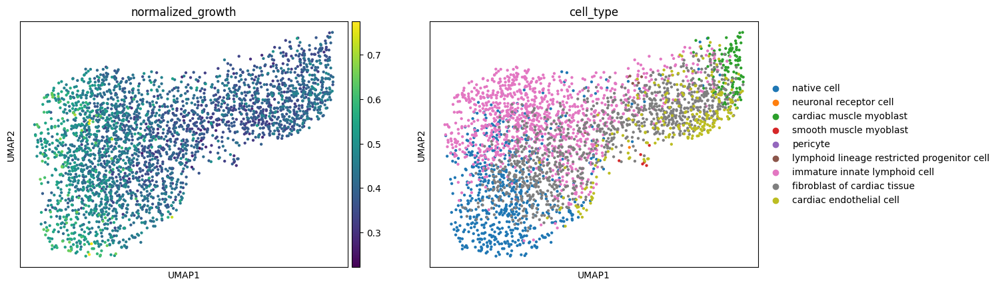

In [72]:
sc.pl.embedding(adata, basis="umap", color=["normalized_growth", "cell_type", ])#, vmax=2, vmin=0.2)

In [73]:
(adata.X>0).sum(1).mean()

3238.22251054168

In [74]:
set(adata.obs.assay)

{'Visium Spatial Gene Expression'}

In [75]:
sc.pp.pca(adata, n_comps=30)
sc.pp.neighbors(adata, use_rep="X_pca")

In [76]:
sc.tl.umap(adata, min_dist=0.1, spread=1.0)

/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


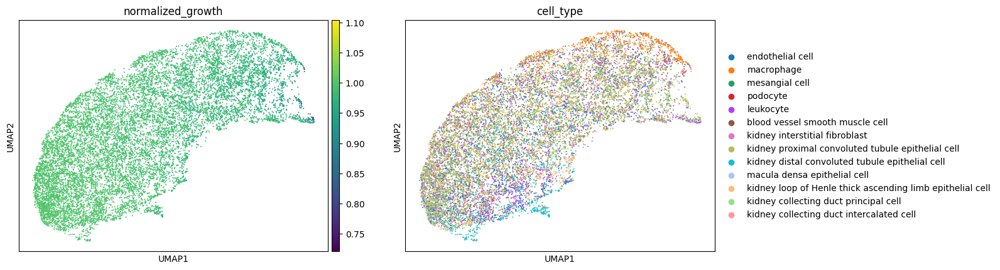

In [65]:
sc.pl.embedding(adata, basis="umap", color=["normalized_growth", "cell_type", ])#, vmax=2, vmin=0.2)

In [ ]:
adata.write()

/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


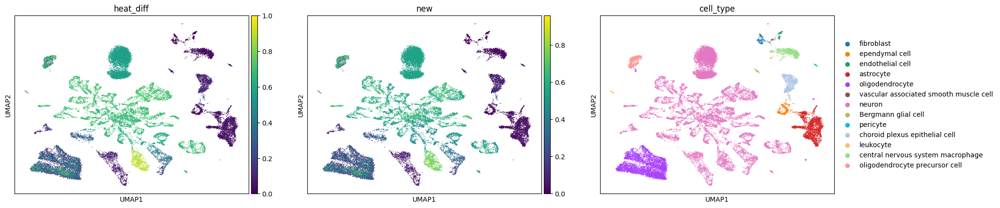

In [39]:
sc.pl.embedding(adata, basis="umap", color=["heat_diff", "new", "cell_type"])

In [4]:
adata = sc.read_h5ad("/tmp/adata.h5ad")

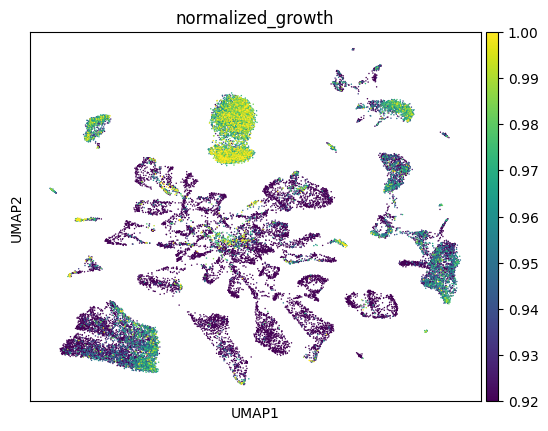

In [6]:
sc.pl.embedding(adata, basis="umap", color=["normalized_growth"], vmin=0.92, vmax=1.0)

In [37]:
adata.obs.normalized_growth.min()


0.2697850909764119

In [38]:
adata.obs.normalized_growth.max()

1.4447050263896655

In [12]:
pk = PseudotimeKernel(adata, time_key="normalized_growth").compute_transition_matrix()

  0%|          | 0/15915 [00:00<?, ?cell/s]

RuntimeError: Compute transition matrix first as `.compute_transition_matrix()`.

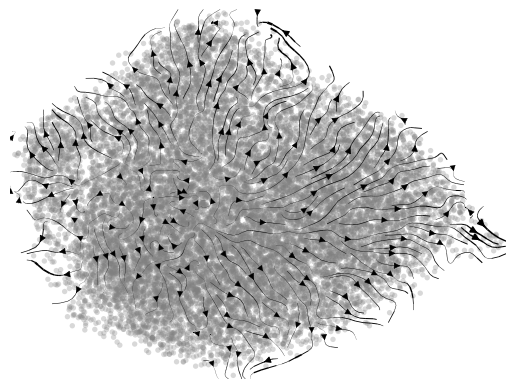

In [ ]:
pk.plot_projection(basis="umap")

In [29]:
adata.obsp['distances'][1203].nonzero()

(array([0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0], dtype=int32),
 array([2530, 2429, 3041, 3141,  952, 2049, 2950, 1285, 2814,  999, 1865,
        2380,  813, 3187], dtype=int32))

In [40]:
adata.obs['normalized_growth'].iloc[10203], adata.obs['normalized_growth'].iloc[adata.obsp['connectivities'][10203].nonzero()[1]]

(0.8958531498341541,
 b34a3c3c-7c60-4307-93df-1f2835440060    0.926859
 857d50cf-986f-4cb4-8159-45343af8f9eb    0.899853
 6efe53eb-3c44-4c9f-93d9-b8cfb28d6c72    0.928524
 946750bc-6c72-43e2-aa36-7688391638e6    0.902835
 fd7a3e59-4d91-40dd-89a2-341b207b9a76    0.918582
 c63beae8-b8d2-441a-8e7d-aa9d2970b7f6    0.811343
 6382b22b-0644-4011-8b71-e96589fff6e2    0.913334
 82f5b1c5-1c19-4162-8f9a-30def95783ea    0.876992
 8410e905-6e03-4760-a195-fd61bb99df9b    0.814896
 db420744-c797-45b2-be4a-10fb80b5077d    0.918137
 fcd795bf-f22e-4d3a-a066-983a02da309d    0.836159
 2b0d8a1c-b6f8-47f1-ae7c-237370d7e742    0.775405
 3bbe19a0-3f15-4461-b8cb-bf1bd4794a3a    0.732883
 5c475bbc-ac3d-4b7b-87ff-299b6a9339ef    0.966334
 0a0e7363-3f0a-404f-8b07-8a9e86c8cc1d    0.856473
 2a1d266f-0696-4d56-96a3-b539249cb02e    0.889470
 169c8660-d4d1-483b-967f-652ee074a593    0.841322
 7dd8d36a-ddc6-4804-acba-ff1c7e94c768    0.918211
 Name: normalized_growth, dtype: float64)

In [28]:
# get their normalized grwoth .obs['normalized_growth'] and apply it to 

(array([0, 0, 0, 0, 0, 0], dtype=int32),
 array([ 813,  952,  999, 2049, 2814, 3187], dtype=int32))

In [ ]:
sc.tl.dpt()

In [9]:
adata

AnnData object with n_obs × n_vars = 27210 × 70116
    obs: 'roi', 'organism_ontology_term_id', 'disease_ontology_term_id', 'self_reported_ethnicity_ontology_term_id', 'assay_ontology_term_id', 'sex_ontology_term_id', 'development_stage_ontology_term_id', 'donor_id', 'suspension_type', 'dissection', 'fraction_mitochondrial', 'fraction_unspliced', 'cell_cycle_score', 'total_genes', 'total_UMIs', 'sample_id', 'supercluster_term', 'cluster_id', 'subcluster_id', 'cell_type_ontology_term_id', 'tissue_ontology_term_id', 'is_primary_data', 'cell_type', 'assay', 'disease', 'organism', 'sex', 'tissue', 'self_reported_ethnicity', 'development_stage', 'cell_culture', 'nnz', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_20_genes', 'total_counts_mt', 'log1p_total_counts_mt', 'pct_counts_mt', 'total_counts_ribo', 'log1p_total_counts_ribo', 'pct_counts_ribo', 'total_counts_hb', 'log1p_total_counts_hb', 'pct_counts_hb', 'outlier', 'mt_outlier'

In [ ]:
adata.obsp

In [3]:
adata = sc.read_h5ad("/home/ml4ig1/scprint/.lamindb/"+files[1])

NameError: name 'files' is not defined

/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(
/home/ml4ig1/miniconda3/envs/scprint/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:394: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


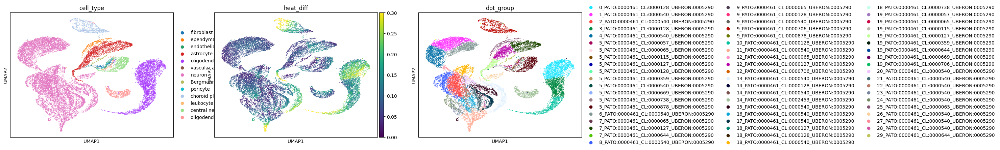

In [4]:
sc.pl.umap(adata, color=["cell_type", "heat_diff", "dpt_group"], vmax=0.3)

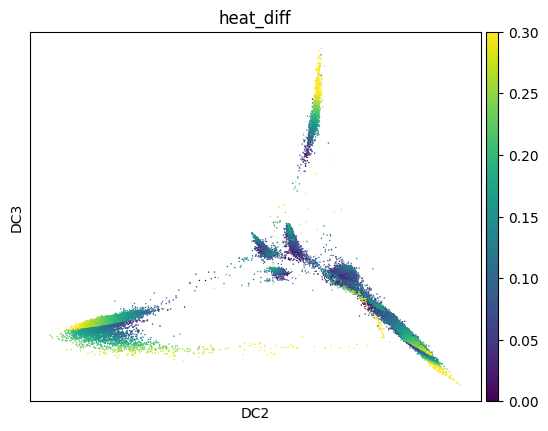

In [7]:
sc.pl.embedding(adata, basis="diffmap", color=['heat_diff'], components=["2,3"], vmax=0.3)